## <center>**Підключення бібліотек**</center>

In [28]:
import pandas as pd
import numpy as np
from rapidfuzz import fuzz
import fuzzy
import matplotlib.pyplot as plt
from tabulate import tabulate
from Levenshtein import distance as levenshtein_distance
from textdistance import damerau_levenshtein, jaro_winkler
import os
from rapidfuzz.distance import JaroWinkler

#### **Читання Файлу**

In [29]:
print(os.path.exists("corner_cases_new.csv"))

True


In [30]:
ds = pd.read_csv("corner_cases_new.csv", encoding='latin1')

print("Розмір даних:", ds.shape)

Розмір даних: (439, 2)


In [31]:
print('columns count - ',len(ds.columns), '\n')
print('columns: ',list(ds.columns))

columns count -  2 

columns:  ['Name1', 'Name2']


## <Center> **Визначення вхідних параметрів** </Center>

#### <center> <p style = 'background-color:darkblue'><b>Довжина термінів</p> </center>

In [32]:
def classify_length(name):
    length = len(str(name))
    if length <= 14:
        return "short"
    elif 15 <= length <= 18:
        return "medium"
    else:
        return "long"

# Додаємо новий стовпець із категоріями довжини
ds['Length Category'] = ds['Name1'].apply(classify_length)

# Подивимось результат
print(ds[['Name1', 'Length Category']].head(15))

# Підрахунок кількості термінів кожної довжини
length_stats = ds['Length Category'].value_counts()

length_stats


                       Name1 Length Category
0                Mehul Gupta           short
1          John Andrew Lewis          medium
2            Cyndi Eric Wood          medium
3                 Mary Ellen           short
4        Carlos Alfonzo Diaz            long
5            Anne Meier-King          medium
6    Michaela Hudson Bennett            long
7          Alyson Colin Gray          medium
8   Britney Alejandro Hughes            long
9             Dwayne Sanders           short
10               Jesse Jones           short
11     Cedric Maxwell Foster            long
12                John Jacob           short
13       Peter Alfred Escher            long
14           Peter James Low          medium


Length Category
long      215
medium    123
short     101
Name: count, dtype: int64

#### <center> <p style = 'background-color:darkblue'><b>Soundex (фонетична схожість)</p> </center>

In [33]:
# Функція для обчислення Soundex
soundex = fuzzy.Soundex(4)
def soundex_similarity(str1, str2):
    str1 = str(str1).encode('ascii', errors='ignore').decode()  # видаляє всі не-ASCII символи
    str2 = str(str2).encode('ascii', errors='ignore').decode()
    return int(soundex(str1) == soundex(str2)) * 100

#### <center> <p style = 'background-color:darkblue'><b>Jaro-Winkler (схожість рядків)</p> </center>

In [34]:
# Функція для обчислення JARO-WINKLER схожості
def jaro_winkler_similarity(str1, str2):
    return round(JaroWinkler.similarity(str1, str2), 2)

#### <center> <p style = 'background-color:darkblue'><b>Damerau-Levenshtein (редакційна відстань)</p> </center>

In [35]:
# Функція для обчислення Damerau-Levenshtein відстані
def damerau_levenshtein_distance(str1, str2):
    return levenshtein_distance(str1, str2)

In [36]:
# Функція для обчислення ймовірності належності на основі вагових коефіцієнтів
def calculate_similarity(name_jw, name_soundex, name_damerau):
    name_damerau_similarity = (100 - name_damerau) / 100
    return round((name_jw * 0.4 + name_soundex * 0.1 + name_damerau_similarity * 0.5), 2)


In [37]:
# Функція для створення таблиці порівнянь між парами записів з усіма полями
def create_comparison_table(ds, threshold=75, label_filter=None):
    results = []
    classical_results = []

    # Якщо вказано label_filter — фільтруємо по ньому
    if label_filter:
        ds = ds[ds['Length Category'] == label_filter].reset_index(drop=True)

    for i in range(len(ds)):
        for j in range(i + 1, len(ds)):
            name1 = ds.loc[i, 'Name1']
            name2 = ds.loc[j, 'Name2']

            name_jw = fuzz.token_sort_ratio(name1, name2) / 100
            name_soundex = soundex_similarity(name1, name2) / 100
            name_damerau = damerau_levenshtein_distance(name1, name2) / max(len(name1), len(name2)) * 100

            distance = damerau_levenshtein_distance(name1, name2)
            probability = calculate_similarity(name_jw, name_soundex, name_damerau)
            decision = "Належить" if probability * 100 >= threshold else "Не належить"

            results.append([
                ds.loc[i, 'Name1'], ds.loc[j, 'Name2'],
                round(name_jw, 2), round(name_soundex, 2), round(name_damerau, 2),
                distance, f"{int(probability * 100)}%", decision
            ])
            

            classical_score = name_jw
            classical_decision = "Належить" if classical_score * 100 >= threshold else "Не належить"

            classical_results.append([name1, name2, round(classical_score * 100, 2), classical_decision])
            
    
    result_df = pd.DataFrame(results, columns=[
                "Name1", "Name2", "Jaro-Winkler", "Soundex", "Damerau-Levenshtein",
                "Damerau-Levenshtein Distance", "Probability of Belonging", "Decision"
            ])
    classical_df = pd.DataFrame(classical_results, columns=[
        "Name1", "Name2", "Jaro-Winkler Score %", "Classical Decision"])

    headers = [
        "Термін 1 (Name)", "Термін 2 (Name)",
        "Name Jaro-Winkler", "Name Soundex", "Name Damerau-Levenshtein",
        "Damerau-Levenshtein", "Ймовірність належності", "Рішення"
    ]

    table = tabulate(results, headers=headers, tablefmt="grid", stralign="center", numalign="center")
    print("\nПриклад виводу системи:")
    print(table)
    return results, headers, result_df, classical_df

In [38]:
# Виклик функції для створення таблиці
results, headers, result_df, classical_df = create_comparison_table(ds, threshold=75)


Приклад виводу системи:
+----------------------------+----------------------------+---------------------+----------------+----------------------------+-----------------------+--------------------------+-------------+
|      Термін 1 (Name)       |      Термін 2 (Name)       |  Name Jaro-Winkler  |  Name Soundex  |  Name Damerau-Levenshtein  |  Damerau-Levenshtein  |  Ймовірність належності  |   Рішення   |
+============================+============================+=====================+================+============================+=======================+==========================+=============+
|        Mehul Gupta         |     Jahn Andrej Levis      |        0.21         |       0        |           88.24            |          15           |           14%            | Не належить |
+----------------------------+----------------------------+---------------------+----------------+----------------------------+-----------------------+--------------------------+-------------+
|        M

#### <center> <p style = 'background-color:darkblue'><b>Топ-10</p> </center>

In [39]:
results.sort(key=lambda x: int(x[-2].replace('%','')), reverse=True)

table_top_10 = tabulate(results[:10], headers=headers, tablefmt="grid", stralign="center", numalign="center")
print("\n🔝 Топ-10 результатів з найвищою ймовірністю належності:")
print(table_top_10)


🔝 Топ-10 результатів з найвищою ймовірністю належності:
+------------------------+-------------------------+---------------------+----------------+----------------------------+-----------------------+--------------------------+-----------+
|    Термін 1 (Name)     |     Термін 2 (Name)     |  Name Jaro-Winkler  |  Name Soundex  |  Name Damerau-Levenshtein  |  Damerau-Levenshtein  |  Ймовірність належності  |  Рішення  |
+========================+=========================+=====================+================+============================+=======================+==========================+===========+
| Saanchi Aniruddh Soman | Saanchi Aniruddh Solman |        0.98         |       1        |            4.35            |           1           |           97%            | Належить  |
+------------------------+-------------------------+---------------------+----------------+----------------------------+-----------------------+--------------------------+-----------+
| Saanchi Aniruddh Soma

#### <center> <p style = 'background-color:darkblue'><b>Порівння класичного методу та нечіткої логіки</p> </center>

In [40]:
result_df.head(10)

,Name1,Name2,Jaro-Winkler,Soundex,Damerau-Levenshtein,Damerau-Levenshtein Distance,Probability of Belonging,Decision
0,Mehul Gupta,Jahn Andrej Levis,0.21,0.0,88.24,15,14%,Не належить
1,Mehul Gupta,Candice Erick Waud,0.21,0.0,88.89,16,14%,Не належить
2,Mehul Gupta,Mari Ehlen,0.19,0.0,81.82,9,17%,Не належить
3,Mehul Gupta,Carlow Diez,0.27,0.0,100.00,11,11%,Не належить
4,Mehul Gupta,Ange Meyer-King,0.23,0.0,93.33,14,13%,Не належить
5,Mehul Gupta,Michael Hudson,0.40,0.0,64.29,9,34%,Не належить
6,Mehul Gupta,Alison Coplin Gray,0.14,0.0,83.33,15,14%,Не належить
7,Mehul Gupta,Britni Alessandro,0.14,0.0,88.24,15,12%,Не належить
8,Mehul Gupta,Dwaine Xander,0.25,0.0,92.31,12,14%,Не належить
9,Mehul Gupta,Jessie Jonas,0.09,0.0,83.33,10,12%,Не належить


In [41]:
classical_df.head(10)

,Name1,Name2,Jaro-Winkler Score %,Classical Decision
0,Mehul Gupta,Jahn Andrej Levis,21.43,Не належить
1,Mehul Gupta,Candice Erick Waud,20.69,Не належить
2,Mehul Gupta,Mari Ehlen,19.05,Не належить
3,Mehul Gupta,Carlow Diez,27.27,Не належить
4,Mehul Gupta,Ange Meyer-King,23.08,Не належить
5,Mehul Gupta,Michael Hudson,40.00,Не належить
6,Mehul Gupta,Alison Coplin Gray,13.79,Не належить
7,Mehul Gupta,Britni Alessandro,14.29,Не належить
8,Mehul Gupta,Dwaine Xander,25.00,Не належить
9,Mehul Gupta,Jessie Jonas,8.70,Не належить


#### <center> <p style = 'background-color:darkblue'><b>Аналіз результатів класичного методу та нечіткої логіки</p> </center>

In [42]:
print("Fuzzy Кількість пар з належністю: ", (result_df["Decision"] == "Належить").sum())
print("Fuzzy Кількість пар без належності:", (result_df["Decision"] == "Не належить").sum())

print("Classic Кількість пар з належністю:", (classical_df["Classical Decision"] == "Належить").sum())
print("Classic Кількість пар без належності:", (classical_df["Classical Decision"] == "Не належить").sum())

Fuzzy Кількість пар з належністю:  223
Fuzzy Кількість пар без належності: 95918
Classic Кількість пар з належністю: 261
Classic Кількість пар без належності: 95880


In [43]:
comparison_df = result_df[["Name1", "Name2", "Decision"]].copy()
comparison_df["Classical Decision"] = classical_df["Classical Decision"]
comparison_df["Різниця"] = comparison_df["Decision"] != comparison_df["Classical Decision"]

comparison_df[comparison_df["Різниця"] == True].head(10)


,Name1,Name2,Decision,Classical Decision,Різниця
467,John Andrew Lewis,Jorn Andrei Lenis,Не належить,Належить,True
919,Cyndi Eric Wood,Wedd Cyndi Eric,Не належить,Належить,True
1340,Mary Ellen,Ellyn Mary,Не належить,Належить,True
1355,Mary Ellen,Marc Elle,Не належить,Належить,True
1760,Carlos Alfonzo Diaz,Carlo Alford Diaz,Не належить,Належить,True
3074,Alyson Colin Gray,Colin Alston Gray,Не належить,Належить,True
3505,Britney Alejandro Hughes,Alejandro Britney Hughie,Не належить,Належить,True
3520,Britney Alejandro Hughes,Britney Leando Hughes,Належить,Не належить,True
3920,Dwayne Sanders,Sanders Dayne,Не належить,Належить,True
3950,Dwayne Sanders,Sandy Dwayne,Не належить,Належить,True


In [44]:
def print_markdown_decision_table(result_df, classical_df):
    # Створення порівняльного датафрейму
    comparison_df = result_df[["Name1", "Name2", "Decision"]].copy()
    comparison_df["Classical Decision"] = classical_df["Classical Decision"]
    comparison_df["Різниця"] = comparison_df["Decision"] != comparison_df["Classical Decision"]

    # Pivot таблиця
    pivot = comparison_df.pivot_table(
        index="Decision",
        columns="Classical Decision",
        aggfunc="size",
        fill_value=0
    )

    # Отримання значень з таблиці (безпечне витягування)
    fuzzy_yes_classic_yes = pivot.get("Належить", {}).get("Належить", 0)
    fuzzy_yes_classic_no = pivot.get("Не належить", {}).get("Належить", 0)
    fuzzy_no_classic_yes = pivot.get("Належить", {}).get("Не належить", 0)
    fuzzy_no_classic_no = pivot.get("Не належить", {}).get("Не належить", 0)

    # Markdown вивід
    print("|                        | Classical: Належить  | Classical: Не належить  |")
    print("|------------------------|----------------------|-------------------------|")
    print(f"| Fuzzy: Належить        | {pivot.loc['Належить', 'Належить'] if ('Належить' in pivot.index and 'Належить' in pivot.columns) else 0}                  | {pivot.loc['Належить', 'Не належить'] if ('Належить' in pivot.index and 'Не належить' in pivot.columns) else 0}                      |")
    print(f"| Fuzzy: Не належить     | {pivot.loc['Не належить', 'Належить'] if ('Не належить' in pivot.index and 'Належить' in pivot.columns) else 0}                   | {pivot.loc['Не належить', 'Не належить'] if ('Не належить' in pivot.index and 'Не належить' in pivot.columns) else 0}                   |")
    
    return pivot

In [45]:
pivot_table = print_markdown_decision_table(result_df, classical_df)

|                        | Classical: Належить  | Classical: Не належить  |
|------------------------|----------------------|-------------------------|
| Fuzzy: Належить        | 208                  | 15                      |
| Fuzzy: Не належить     | 53                   | 95865                   |


## <Center> **Формування нечітких множин для кожного параметра** </Center>

In [46]:
def interpret_similarity(score):
    if score < 0.4:
        return 'low'
    elif 0.4 <= score < 0.7:
        return 'medium'
    else:
        return 'high'

def interpret_soundex(score):
    if score == 1:
        return 'Full'
    elif score == 0.5:
        return '50/50'
    else:
        return 'Empty'

def create_comparison_table(ds, threshold=75, label_filter=None):
    results = []

    if label_filter:
        ds = ds[ds['Length Category'] == label_filter].reset_index(drop=True)

    for i in range(len(ds)):
        for j in range(i + 1, len(ds)):
            name1 = ds.loc[i, 'Name1']
            name2 = ds.loc[j, 'Name2']

            name_jw = fuzz.token_sort_ratio(name1, name2) / 100
            name_soundex = soundex_similarity(name1, name2) / 100
            name_damerau = damerau_levenshtein_distance(name1, name2) / max(len(name1), len(name2)) * 100

            probability = calculate_similarity(name_jw, name_soundex, name_damerau)
            decision = "Належить" if probability * 100 >= threshold else "Не належить"

            # Інтерпретовані категорії
            similarity_level = interpret_similarity(probability)
            soundex_level = interpret_soundex(name_soundex)
            lenght_u1 = classify_length(name1)
            lenght_u2 = classify_length(name2)
            length_cat_1 = ds.loc[i, 'Length Category']
            length_cat_2 = ds.loc[j, 'Length Category']
            
            # Ініціалізація змінних перед правилами
            rule_1_prob_sound = "-"
            rule_2_prob_length = "-"
            rule_3_prob_sound = "-"

            # Rule 1: Висока схожість + повна фонетична -> одна група
            if similarity_level == 'high' and soundex_level == 'Full':
                rule_1_prob_sound = "Одна група"
            # Rule 2: Середня схожість + короткі терміни -> висока приналежність
            if similarity_level == 'medium' and lenght_u1 == "short" and lenght_u2 == "short":
                rule_2_prob_length = "Висока приналежність"
            # Rule 3: Низька схожість + порожній Soundex -> різні групи
            if similarity_level == 'low' and soundex_level == 'Empty':
                rule_3_prob_sound = "Терміни належать до різних груп"


            results.append([
                name1, name2,
                round(probability * 100, 2), 
                decision,
                similarity_level, 
                soundex_level,
                length_cat_1, length_cat_2, 
                rule_1_prob_sound, rule_2_prob_length, rule_3_prob_sound
            ])

    comparison_df = pd.DataFrame(results, columns=[
        'Name1', 'Name2', 
        'Similarity %', 
        'Decision',
        'Ступінь схожості', 
        'Фонетична схожість',
        'Length1', 'Length2', 
        'Rule 1 Probability Soundex', 'Rule 2 Probability Length', 'Rule 3 Probability Soundex(empty)'

    ])

    return comparison_df


In [47]:
# create_comparison_table(ds, threshold=75)

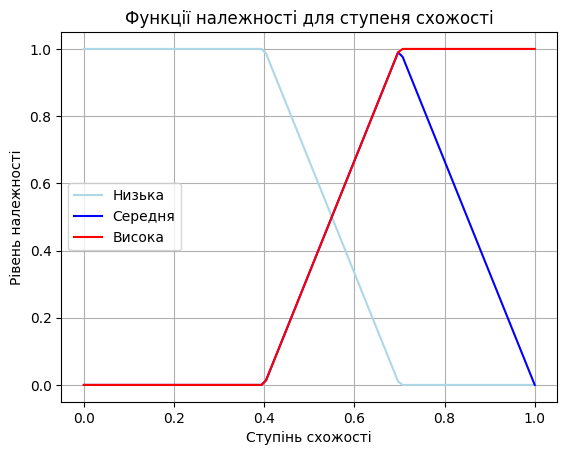

In [48]:
import numpy as np
import matplotlib.pyplot as plt

x = np.linspace(0, 1, 100)

# Функції належності
low = np.where(x <= 0.4, 1, np.where(x <= 0.7, (0.7-x)/0.3, 0))
medium = np.where((x >= 0.4) & (x <= 0.7), (x-0.4)/0.3, np.where((x > 0.7) & (x <= 1), (1-x)/0.3, 0))
high = np.where(x >= 0.7, 1, np.where(x >= 0.4, (x-0.4)/0.3, 0))

plt.plot(x, low, label='Низька', color='lightblue')
plt.plot(x, medium, label='Середня', color='blue')
plt.plot(x, high, label='Висока', color='red')
plt.title('Функції належності для ступеня схожості')
plt.xlabel('Ступінь схожості')
plt.ylabel('Рівень належності')
plt.legend()
plt.grid()
plt.show()